In [159]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [160]:
from jax import vmap, jit
import jax.numpy as jnp
from pathlib import Path
import numpy as np
from einops import rearrange
import jax
import matplotlib.pyplot as plt
import seaborn as sns
from hflow.misc.plot import scatter_movie, imshow_movie

In [161]:
import jax.random
from diffrax import diffeqsolve, ControlTerm, Euler, MultiTerm, ODETerm, SaveAt, VirtualBrownianTree, Heun, WeaklyDiagonalControlTerm
import random



In [162]:
from hflow.data.vlasov import run_vlasov
from hflow.misc.misc import (gauss_quadrature_weights_points,
                             pts_array_from_space)
from hflow.train.sample import interplate_in_t
from hflow.data.utils import normalize


bs_t = 128
n_samples = 10_000
n_t = 1000
t0, t1 = 0, 40
t_eval = np.linspace(t0, t1, n_t)
mu = 1.3
sols = run_vlasov(n_samples, t_eval, mu, mode='two-stream')



t_train = t_eval / t_eval[-1]
t_train = t_train.reshape(-1, 1)
g_pts_01, quad_weights = gauss_quadrature_weights_points(
    bs_t, a=0.0, b=1.0)

start, end = jnp.asarray([0]), jnp.asarray([1.0])
g_pts_01 = jnp.concatenate([start, g_pts_01, end])

sols = rearrange(np.expand_dims(sols, 0), 'M T N D -> T M N D')
# interp
sols = interplate_in_t(sols, t_train, g_pts_01)
sols = rearrange(sols, 'T M N D -> (T M) N D')

t_train = g_pts_01.reshape(-1,1)
sols, d_shift, d_scale = normalize(
    sols, axis=(0, 1), return_stats=True, method='01')

scatter_movie(sols, alpha=0.1)

In [181]:
from hflow.net.build import build_colora
from typing import List, Optional

import jax.numpy as jnp
from jax.flatten_util import ravel_pytree

from hflow.net.networks import DNN
from hflow.net.utils import init_net, merge, split
from hflow.net.build import build_colora

key = jax.random.PRNGKey(random.randint(0,1e8))

x_dim = 2
mu_t_dim = 1
u_dim = 1

u_layers = ['C']*6
h_layers = ['D']*5
rank = 3
full = False

lora_filter = ['alpha']

u_config = {'width': 35, 'layers': u_layers}
h_config = {'width': 35, 'layers': h_layers}


u_fn, h_fn, theta_init, psi_init = build_colora(u_config, h_config, x_dim, mu_t_dim, u_dim, rank=rank, key=key, full=full)

def s(t, x, params):
    psi, theta = params
    phi = h_fn(psi, t)
    return jnp.squeeze(u_fn(theta, phi, x))

s_params_init = (psi_init,theta_init)

In [182]:
key = jax.random.PRNGKey(random.randint(0,1e8))
u_config = {'width': 35, 'layers': u_layers, 'last_activation': 'none'}
u_rho_fn, h_rho_fn, theta_init_rho, psi_init_rho = build_colora(u_config, h_config, x_dim, mu_t_dim, u_dim, rank=rank, key=key, full=full,)

def log_rho(t, x, params):
    psi, theta = params
    phi = h_rho_fn(psi, t)
    p = u_rho_fn(theta, phi, x)
    return jnp.squeeze(p)

rho_params_init = (psi_init_rho, theta_init_rho)

In [183]:
params_init = (s_params_init, rho_params_init)

In [184]:
from jax import jit, jvp, grad, jacrev, jacfwd
from functools import partial
from hflow.misc.jax import hess_trace_estimator

s_dt = jacrev(s, 0)
s_dt_Vx = vmap(s_dt, (None, 0, None))
s_dt_Vx_Vt = vmap(s_dt_Vx, (0, None, None))

s_Vx = vmap(s, in_axes=(None, 0, None))
s_Vx_Vt = vmap(s_Vx, in_axes=(0, None, None))
s_dx = jacrev(s, 1)
s_dx_Vx = vmap(s_dx, in_axes=(None, 0, None))
s_ddx_Vx = vmap(jacfwd(s_dx, 1), (None, 0, None))
s_dt_dx = jacrev(s, (0, 1))
s_dt_dx_Vx = vmap(s_dt_dx, in_axes=(None, 0, None))

trace_dds = hess_trace_estimator(s, argnum=1)
trace_dds_Vx = vmap(trace_dds, (None, None, 0, None))

rho_Vx = vmap(log_rho, in_axes=(None, 0, None))
rho_Vx_Vt = vmap(rho_Vx, in_axes=(0, None, None))

log_rho_dt = jacrev(log_rho, 0)
log_rho_dt_Vx = vmap(log_rho_dt, (None, 0, None))

In [185]:


def score_match(t, x, params):
    grad_log_p = jacfwd(log_rho, 1)(t, x, params)
    hess_log_p = jacrev(jacfwd(log_rho, 1), 1)(t, x, params)
    l1 = jnp.sum(jnp.diag(hess_log_p))
    l2 = 0.5*jnp.linalg.norm(grad_log_p)**2
    return l1 + l2 

v_score_match = vmap(score_match, (None, 0, None))





def sliced_score_match(key, t, x, params):

    grad_log_p = jacfwd(log_rho, 1)(t, x, params)
    hess_log_p = hess_trace_estimator(log_rho, argnum=1)
    grad_log_p, l1 = hess_log_p(key, t, x, params)

    l2 = 0.5*jnp.linalg.norm(grad_log_p)**2
    return l1 + l2 

v_sliced_score_match = vmap(sliced_score_match, (None, None, 0, None))


In [186]:
from jax.experimental.host_callback import id_print, id_tap

import jax.flatten_util


noise = 0.0
sigma = 1e-1



def am_loss(params, x_t_batch, t_batch, key):
    
    s_params, rho_params = params


    T, N, D = x_t_batch.shape
    T, MT = t_batch.shape
    bound = s_Vx(t_batch[0], x_t_batch[0], s_params) - \
        s_Vx(t_batch[-1], x_t_batch[-1], s_params)
        
    x_t_batch = x_t_batch[1:-1]
    t_batch = t_batch[1:-1]

    xt_tensor = rearrange(x_t_batch, 'T N D -> T (N D)')
    xt_tensor = jnp.hstack([xt_tensor, t_batch])

    def interior_loss(xt_tensor):
        x_batch, t = xt_tensor[:-MT], xt_tensor[-MT:]
        x_batch = rearrange(x_batch, '(N D) -> N D', D=D)

        ut = s_dt_Vx(t, x_batch, s_params)
        ut = jnp.squeeze(ut)
        
        
        # rt = jnp.squeeze(log_rho_dt_Vx(t, x_batch, rho_params))
        # ss = s_Vx(t, x_batch, s_params)
        # ut = ss*rt*-1
        # print(rt.shape, ss.shape, ut.shape)
        # # entropic
        if sigma > 0.0:
            gu, trace_ets = trace_dds_Vx(key, t, x_batch, s_params)
            ent = trace_ets*sigma**2*0.5
        else:
            gu = s_dx_Vx(t, x_batch, s_params)
            ent = 0.0
        gu = 0.5*jnp.sum(gu**2, axis=1)
    
        return gu.mean() + ut.mean() + ent.mean() 
    
    def vX_VT_score_match(xt_tensor):
        x_batch, t = xt_tensor[:-MT], xt_tensor[-MT:]
        x_batch = rearrange(x_batch, '(N D) -> N D', D=D)
        sm = v_score_match(t, x_batch, rho_params)
 
        return sm.mean()
    
    score = vmap(vX_VT_score_match)(xt_tensor)
  
    score *= quad_weights
    score_loss =  score.sum()

    
    interior = vmap(interior_loss)(xt_tensor)
    interior *= quad_weights

    loss = bound.mean() + interior.sum() #+ score_loss
    
    # loss=  score.mean()


    return loss 


def get_rand_idx(key, N, bs):
    idx = jnp.arange(0, N)
    return jax.random.choice(key, idx, shape=(bs,), replace=False)



def get_data_fn(sols, t_data, bs_n, bs_t):
    T, N, D = sols.shape

    def args_fn(key, *args):

        nonlocal sols
        nonlocal t_data

        key, keyt = jax.random.split(key)
 
        # t_idx = jax.random.choice(keyt, jnp.arange(1,T-1), shape=(bs_t-2,), replace=False)
        # start, end = jnp.asarray([0]), jnp.asarray([T-1])
        # t_idx = jnp.concatenate([start, t_idx, end])

        keys = jax.random.split(key, num=bs_t+2)
        keys *= 0 + key[0] 
        sample_idx = vmap(get_rand_idx, (0, None, None))(keys, N, bs_n)
        
        sols_sample = sols #[t_idx]
        t_sample = t_data #[t_idx]

        sols_sample = sols_sample[np.arange(len(sols_sample))[:, None], sample_idx]

        return sols_sample, t_sample
    return args_fn





In [187]:
bs_n = 256
key = jax.random.PRNGKey(np.random.randint(0,1e5))
args_fn = get_data_fn(sols, t_train, bs_n, bs_t)
x_t_batch, t_batch = args_fn(key)
x_t_batch.shape, t_batch.shape

((130, 256, 2), (130, 1))

In [188]:
from hflow.train.adam import adam_opt

last_params, opt_params, loss_history, param_history = adam_opt(params_init, am_loss, args_fn, steps=5_000, learning_rate=5e-3, verbose=True, scheduler=True, key=key, return_params=True, optimizer='adamw')



  0%|          | 0/5000 [00:00<?, ?it/s]

In [189]:
len(param_history)

1000

In [190]:
opt_params = param_history[-1]

In [191]:
nx = 50
xA, xB = sols[:, :, 0].min(), sols[:, :, 0].max()
yA, yB = sols[:, :, 1].min(), sols[:, :, 1].max()
x1, x2 = jnp.linspace(xA, xB, nx), jnp.linspace(yA, yB, nx)
m_grids = jnp.meshgrid(x1, x2,  indexing='ij')
x_grid = jnp.asarray([m.flatten() for m in m_grids]).T

t_test = t_train

pred = s_Vx_Vt(t_test, x_grid, opt_params[0])
pred = rearrange(pred, 'T (N1 N2)-> T N1 N2', T=len(t_test), N1=nx, N2=nx)
pred = jnp.exp(pred)
imshow_movie(pred, live_cbar=True)


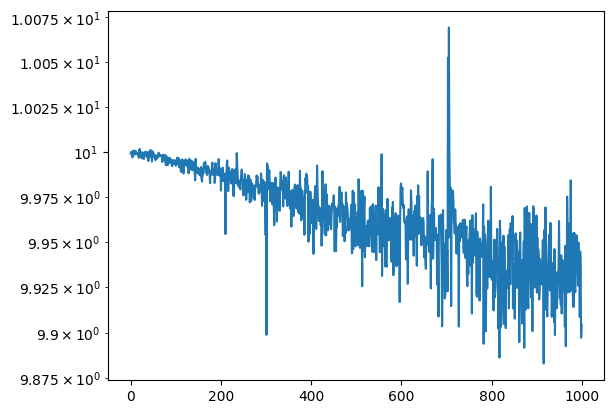

In [192]:
plt.semilogy(loss_history+10)
plt.show()

In [193]:
# res = np.asarray(res)
# plt.semilogy(res)
# plt.legend(['gu','ut', 'gu weight', 'ut weight'])
# plt.show()

# plt.plot(res)
# plt.legend(['gu','ut', 'gu weight', 'ut weight'])
# plt.show()

In [194]:
nx = 50
xA, xB = sols[:, :, 0].min(), sols[:, :, 0].max()
yA, yB = sols[:, :, 1].min(), sols[:, :, 1].max()
x1, x2 = jnp.linspace(xA, xB, nx), jnp.linspace(yA, yB, nx)
m_grids = jnp.meshgrid(x1, x2,  indexing='ij')
x_grid = jnp.asarray([m.flatten() for m in m_grids]).T

t_int = np.linspace(0.0, 1.0, 256).reshape(-1,1)

pred = s_Vx_Vt(t_int, x_grid, opt_params[0])
pred = rearrange(pred, 'T (N1 N2)-> (T) N1 N2', T=len(t_int), N1=nx, N2=nx)

imshow_movie(pred, live_cbar=True, t=t_int[:, 0])


In [195]:
from hflow.data.sde import solve_sde_ic

def solve_test_sde(s_fn, params, ics, t_int, dt, sigma,  key):
    s_dx = jacrev(s_fn, 1)

    def drift(t, y, *args):
        f = jnp.squeeze(s_dx(t.reshape(1), y, params))
        return f

    def diffusion(t, y, *args):
        return sigma * jnp.ones_like(y)

    keys = jax.random.split(key, num=len(ics))
    test_sol = vmap(solve_sde_ic, (0, 0, None, None, None, None))(
        ics, keys, t_int, dt, drift, diffusion)
    test_sol = rearrange(test_sol, 'N T D -> T N D')

    return test_sol


t_int = np.linspace(0.0, 1.0, 256)

samples_idx = get_rand_idx(key, sols.shape[1], 10_000)
ics = sols[0, samples_idx, :]

test_sol = solve_test_sde(s, opt_params[0], ics, t_int, 1e-3, sigma, key)

In [196]:
from hflow.test.plot import get_hist

H = get_hist(test_sol)

imshow_movie(H)

In [197]:
ss = 10
scatter_movie(test_sol[:, ::ss], t=np.squeeze(t_train), xlim=[0,1], ylim=[0,1])